In [1]:
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import scanpy as sc

In [2]:
mc_df = pd.read_csv("bulk/music_wctrl/proportions_0.25_correlation_wBM.tsv",sep="\t",index_col=0)

In [3]:
sc_meta = pd.read_csv("scRNA/adata_clustered_wctrl_harm_cluster_merged_meta_redo.tsv",sep="\t",index_col=0)

In [4]:
clusters = list(set(sc_meta['merged_clusters_from_4']))

In [5]:
morphogen_bm = ['M_XAV','M_CHIR','M_RA','M_FGF8','M_BMP4','M_SHH','M_CycA','M_NIM','M_N2B27_2Si','M_N2B27_SB_CHIR']
cluster_morph_correlation = pd.DataFrame(index=clusters,columns=morphogen_bm)

for cluster in clusters:
    a = sc_meta.loc[sc_meta['merged_clusters_from_4']==cluster,'leiden_0.25'].value_counts()
    
    for morphogen in morphogen_bm:
        w = 0
        cells_used = 0
        for cl in a.index:
            if str(cl) in mc_df.index:
                w = a[cl]*mc_df.loc[str(cl),morphogen] + w
                cells_used = cells_used + a[cl]
        if cells_used==0:
            w=0
        else:
            w = w/cells_used
        sc_meta.loc[sc_meta['merged_clusters_from_4']==cluster,morphogen] = w
        cluster_morph_correlation.loc[cluster,morphogen] = w

In [6]:
cluster_morph_correlation.loc[31].sort_values()

M_NIM             -0.213021
M_N2B27_2Si       -0.200921
M_XAV             -0.163108
M_CHIR             -0.14494
M_CycA            -0.104183
M_RA              -0.069392
M_SHH              0.077493
M_FGF8             0.094161
M_BMP4             0.155526
M_N2B27_SB_CHIR    0.462801
Name: 31, dtype: object

In [7]:
print(list(mc_df.columns))

['M_XAV', 'M_CHIR', 'M_RA', 'M_FGF8', 'M_BMP4', 'M_SHH', 'M_PM', 'M_CycA', 'M_NIM', 'M_N2B27_2Si', 'M_N2B27_SB_CHIR', '5', '8', '6', '2', '4', '9', '0', '7', '1']


In [8]:
import numpy as np
def cluster_avg(adata,clustering):
    cluster_avg_subset = pd.DataFrame(columns=adata.var_names, index=adata.obs[clustering].cat.categories)                                                                                                 
    for clust in adata.obs[clustering].cat.categories: 
        cluster_avg_subset.loc[clust] = adata[adata.obs[clustering].isin([clust]),:].X.mean(0)


    cluster_avg_subset = cluster_avg_subset.astype('float')
    cluster_avg_subset = cluster_avg_subset.T
    return(cluster_avg_subset)

def find_TF_NES(me_df,TF):
    me_df_subset = me_df[['Direct_annot','NES']].copy()
    me_df_subset = me_df_subset.dropna()
    # Split the strings into lists
    me_df_subset['Direct_annot_list'] = me_df_subset['Direct_annot'].str.split(', ')

    # Use apply with a lambda function to check if the string is present in each list
    me_df_filtered = me_df_subset[me_df_subset['Direct_annot_list'].apply(lambda x: TF in x)]

    max_NES = me_df_filtered['NES'].max()
    if len(me_df_filtered)>0:
        TF_motif = me_df_filtered['NES'].idxmax()
    else:
        TF_motif = max_NES
    return(max_NES,TF_motif)

In [9]:
import dill
menr = dill.load(open('motifs_redo_vs_control/menr.pkl', 'rb'))

In [10]:
HG_TFS_FNAME = '/home/jjanssens/jjans/resources/resources.aertslab.org/cistarget/tf_lists/allTFs_hg38.txt'
HG_TFs = pd.read_csv(HG_TFS_FNAME,sep="\t",header=None)
HG_TFs = list(HG_TFs[0])
HG_TFs1 = HG_TFs.copy()

HG_TFS_FNAME = '/home/jjanssens/jjans/resources/geneLists/human_TFs/utoronto_human_tfs_v_1.01.txt'
HG_TFs = pd.read_csv(HG_TFS_FNAME,sep="\t",header=None)
HG_TFs = list(HG_TFs[0])
HG_TFs2 = HG_TFs.copy()

HG_TFs = HG_TFs1 + HG_TFs2
HG_TFs = list(sorted(set(HG_TFs)))

In [11]:
menr.keys()

dict_keys(['CTX_DARs_up_All', 'CTX_DARs_up_No_promoters', 'DEM_DARs_up_All', 'DEM_DARs_up_No_promoters', 'CTX_DARs_dw_All', 'CTX_DARs_dw_No_promoters', 'DEM_DARs_dw_All', 'DEM_DARs_dw_No_promoters'])

In [12]:
me_celltypes = list(menr['CTX_DARs_up_All'].keys())
print(len(me_celltypes))

33


In [13]:
adata = sc.read_h5ad("scRNA/adata_clustered_wctrl_harm_cluster_merged_redo.h5ad")
adata2 = sc.read_h5ad("scRNA/adata_clustered_wctrl_harm_cluster_redo.h5ad")

In [14]:
adata.obsm = adata2.obsm
adata.obsp = adata2.obsp
adata.obs['final_clustering'] = adata.obs['merged_clusters_from_4']

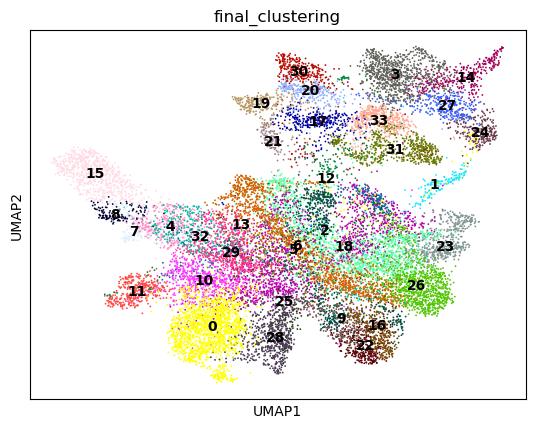

In [15]:
sc.pl.umap(adata,color=['final_clustering'],legend_loc='on data')

In [16]:
#preprocess adata
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

In [17]:
cluster_avg_subset = cluster_avg(adata,'final_clustering')

In [18]:
sc.settings.set_figure_params(dpi=300, frameon=False)
sc.set_figure_params(dpi=300)
sc.set_figure_params(figsize=(3, 3))
plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.figsize'] = (3, 3)


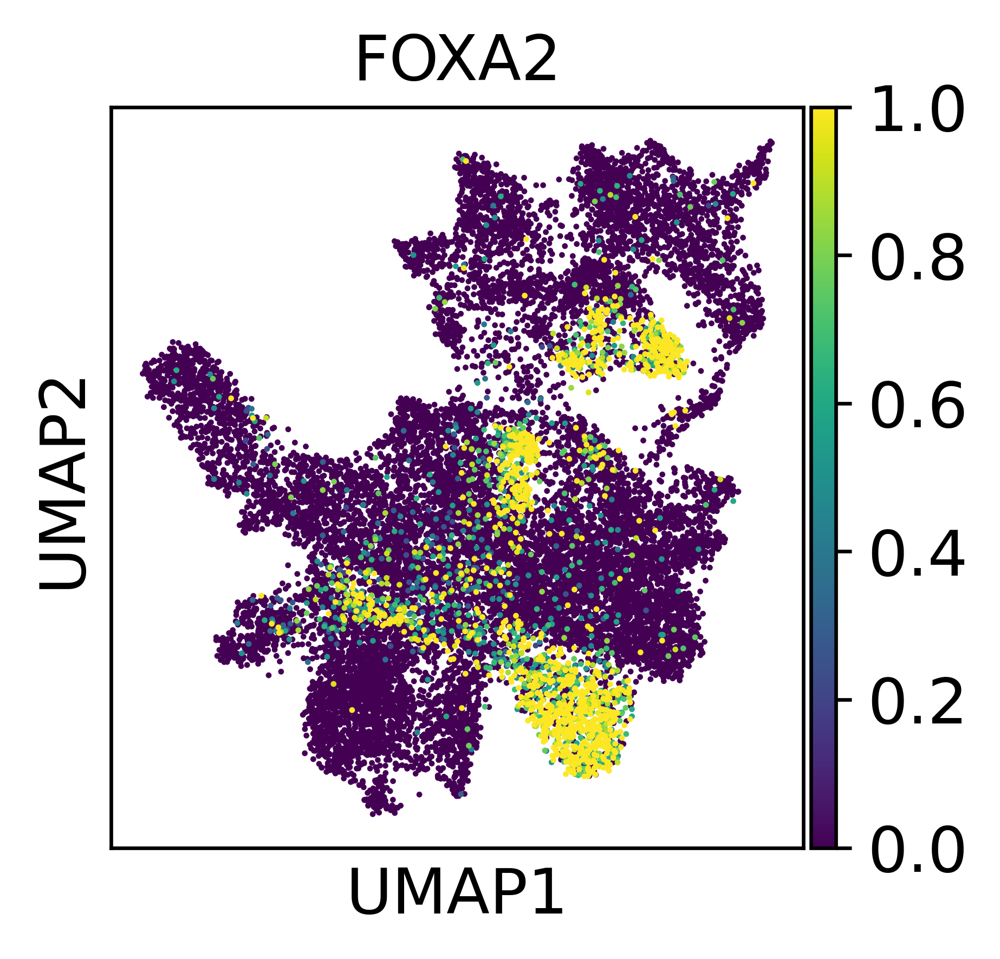

In [19]:
sc.pl.umap(adata,color=['FOXA2'],vmax=1)

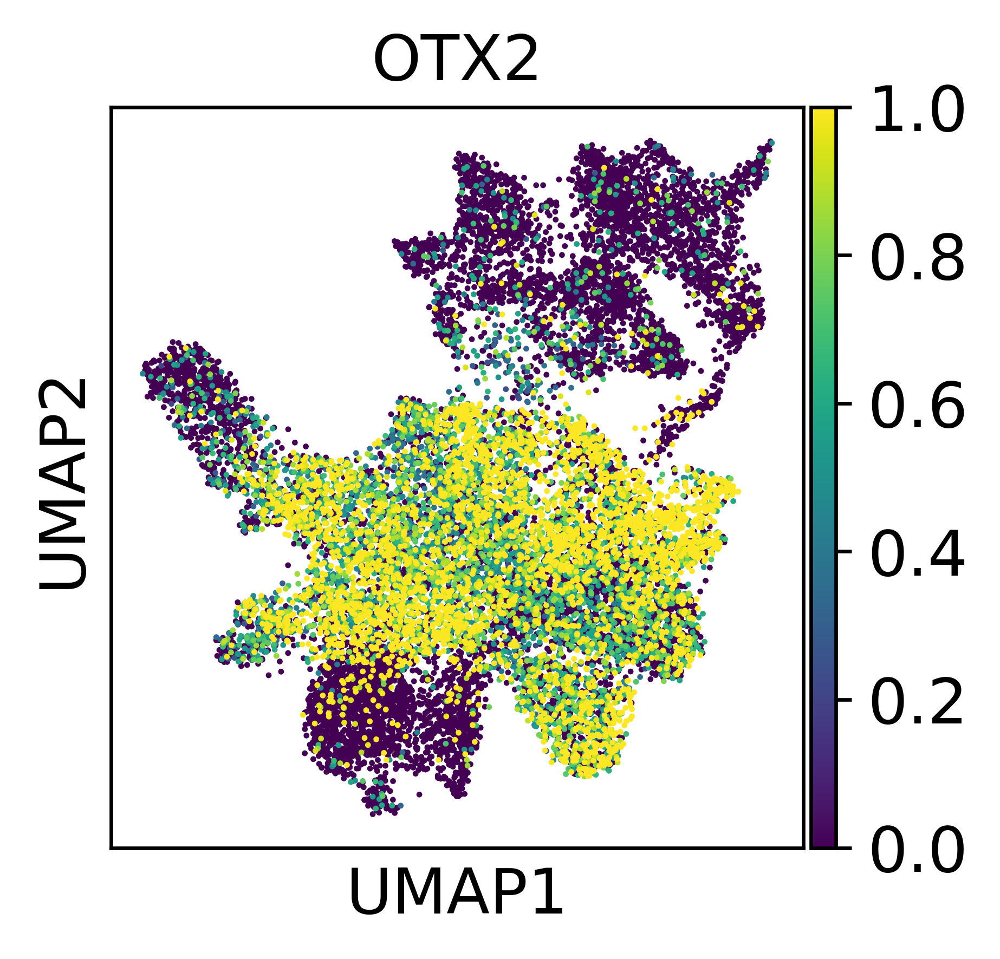

In [21]:
sc.pl.umap(adata,color=['OTX2'],vmax=1)

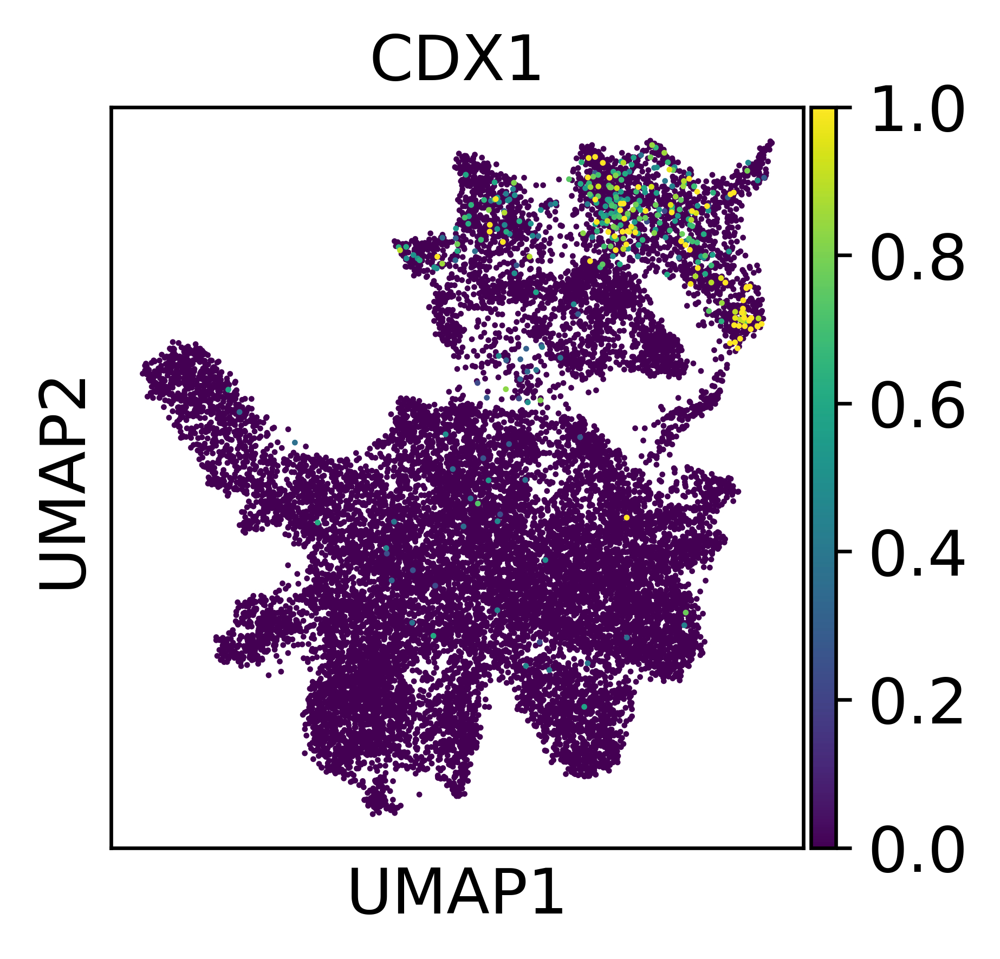

In [20]:
sc.pl.umap(adata,color=['CDX1'],vmax=1)

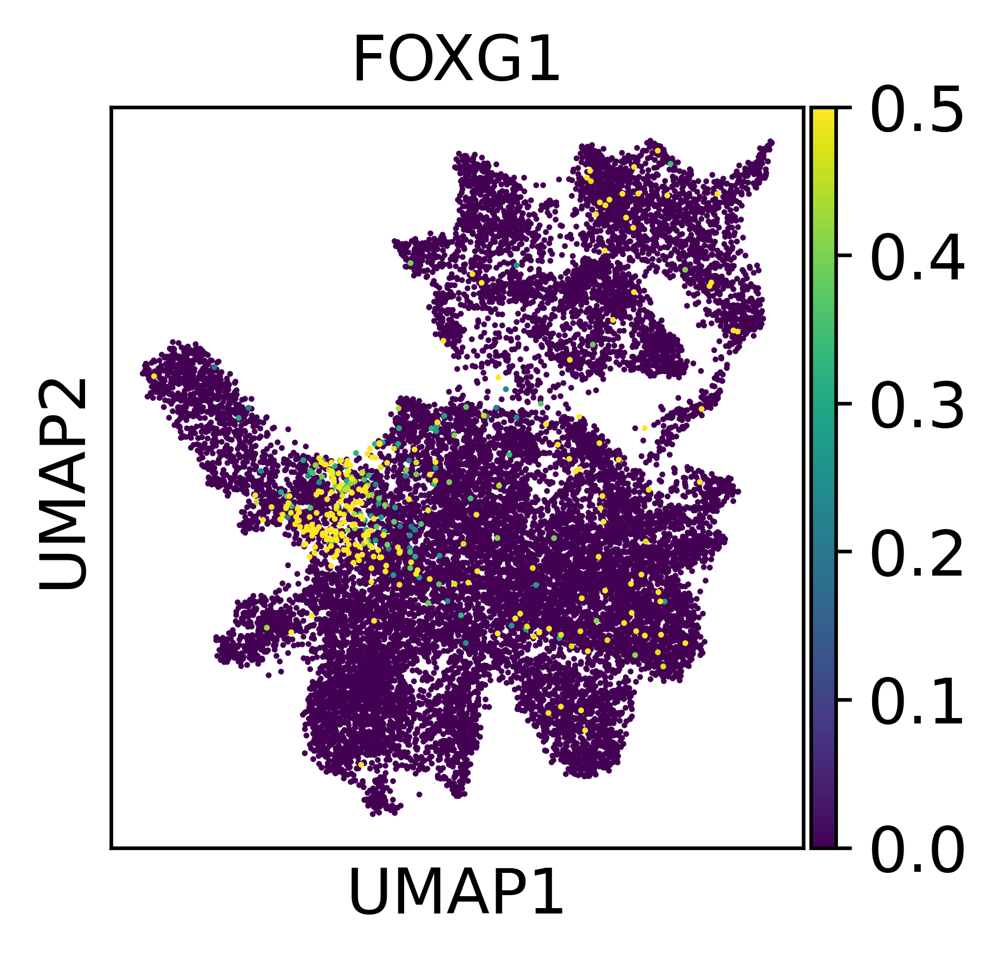

In [21]:
sc.pl.umap(adata,color=['FOXG1'],vmax=0.5)

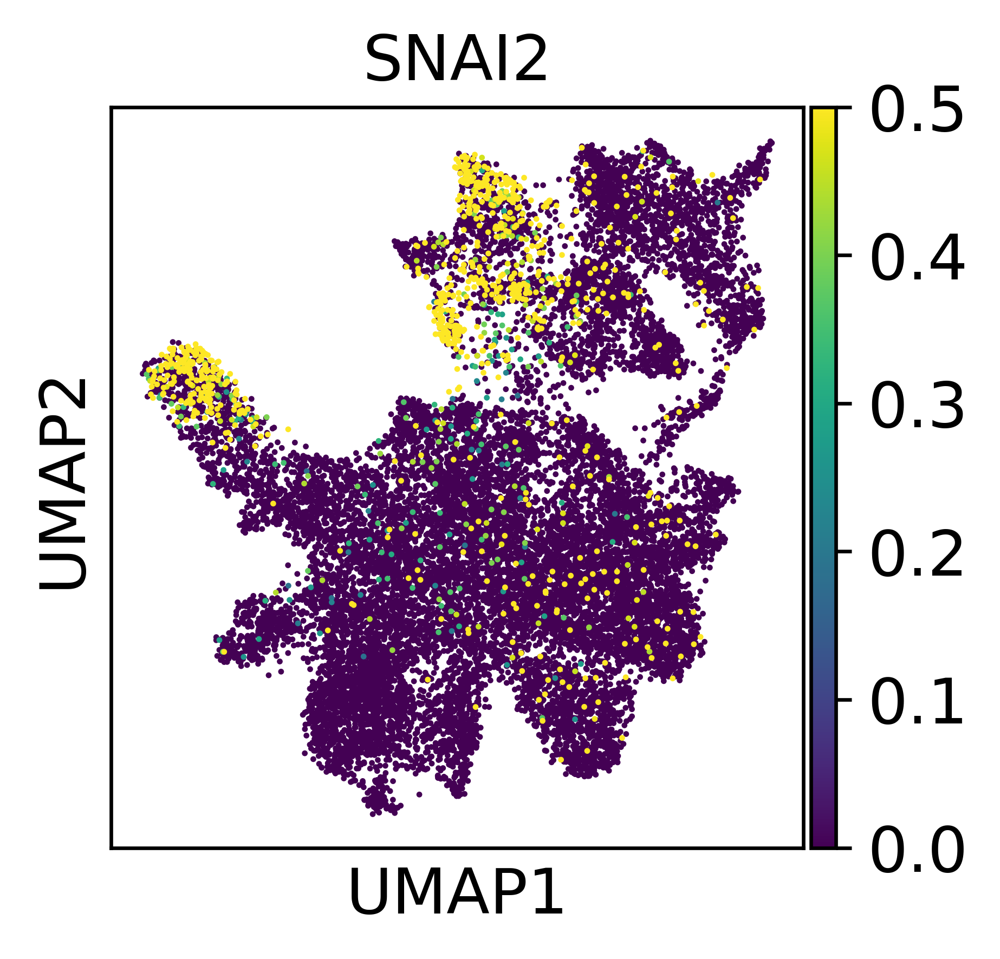

In [22]:
sc.pl.umap(adata,color=['SNAI2'],vmax=0.5)

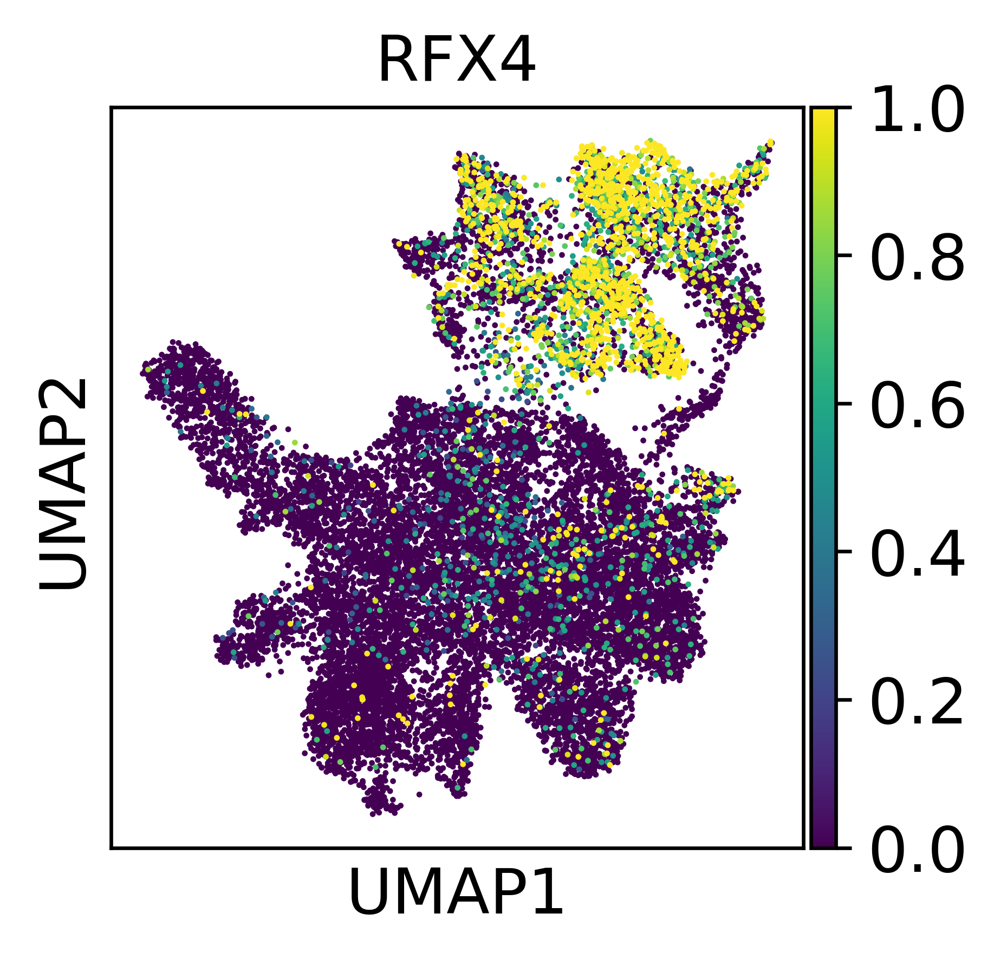

In [23]:
sc.pl.umap(adata,color=['RFX4'],vmax=1)

In [24]:
sc.settings.set_figure_params(dpi=300, frameon=False)
sc.set_figure_params(dpi=300)
sc.set_figure_params(figsize=(3, 3))
plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.figsize'] = (3, 3)


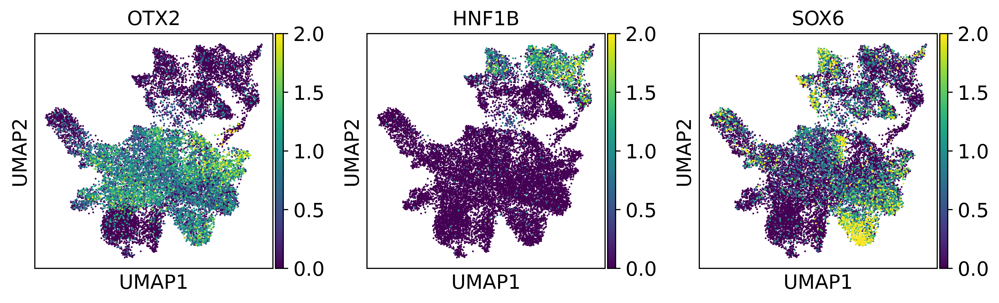

In [143]:
sc.pl.umap(adata,color=['OTX2','HNF1B','SOX6'],vmax=2)

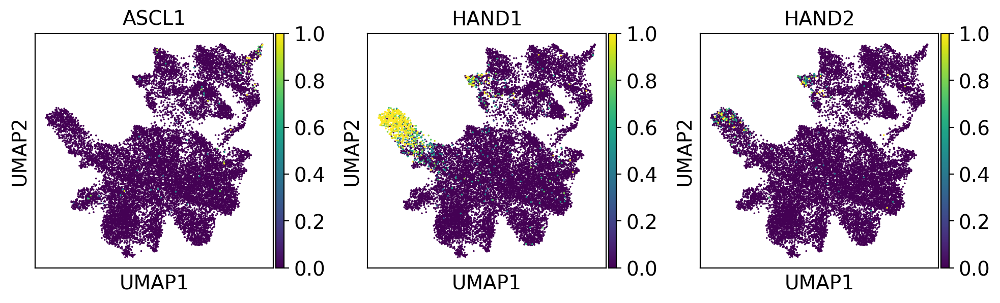

In [67]:
sc.pl.umap(adata,color=['ASCL1','HAND1','HAND2'],vmax=1)

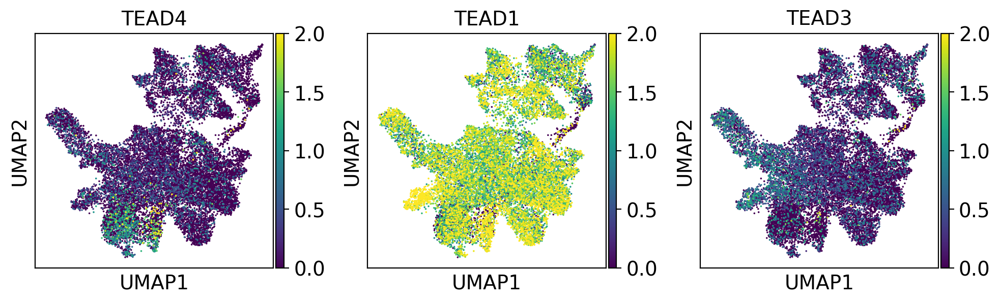

In [71]:
sc.pl.umap(adata,color=['TEAD4','TEAD1','TEAD3'],vmax=2)

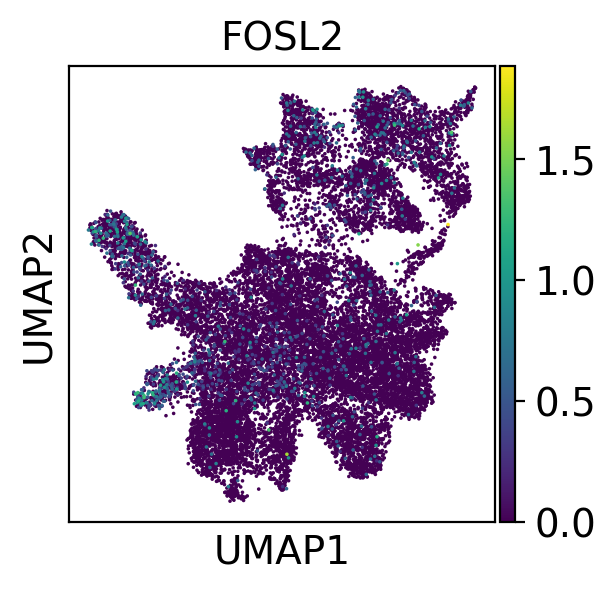

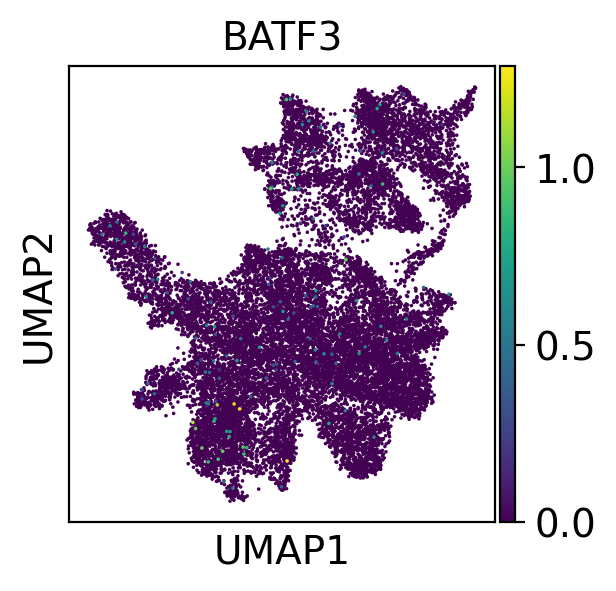

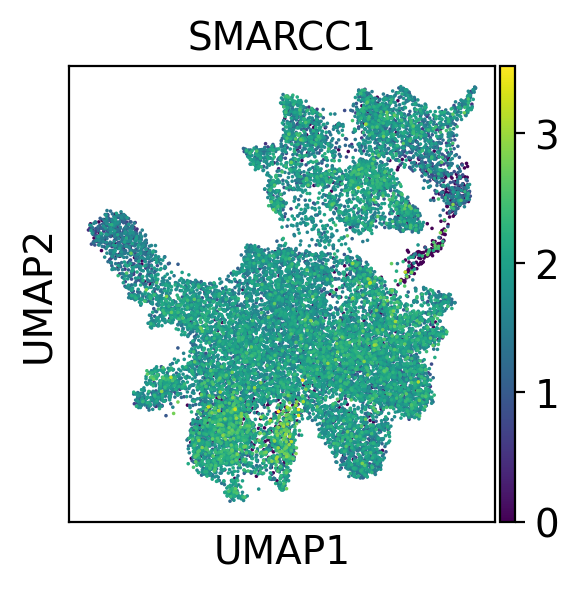

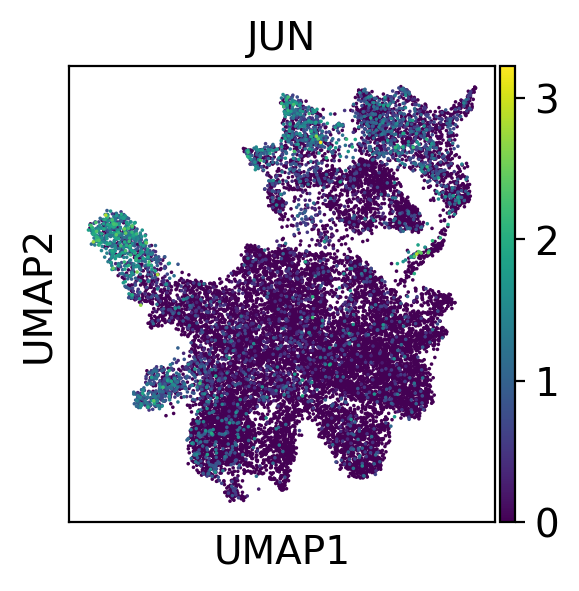

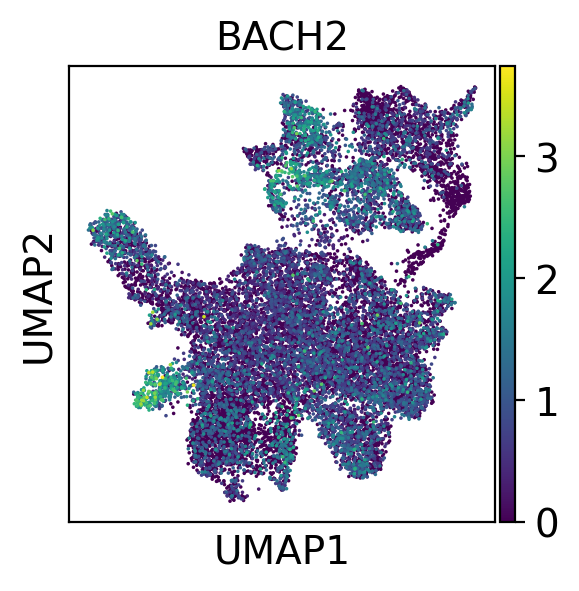

...

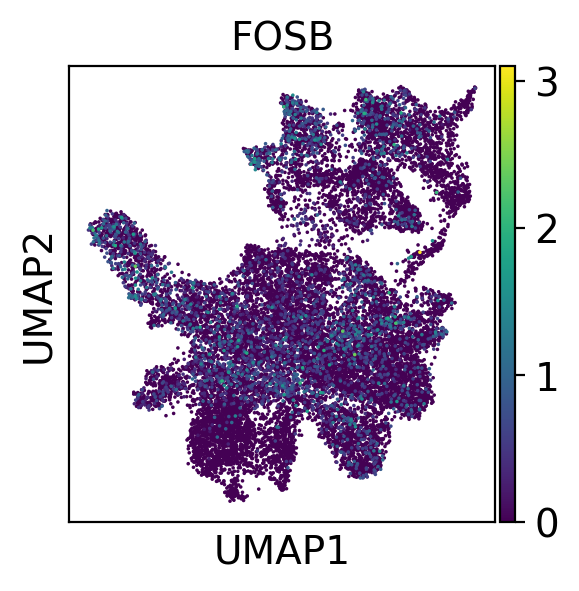

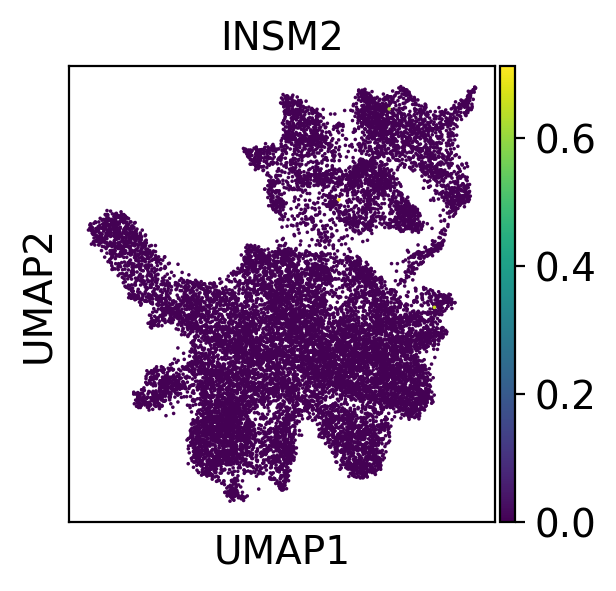

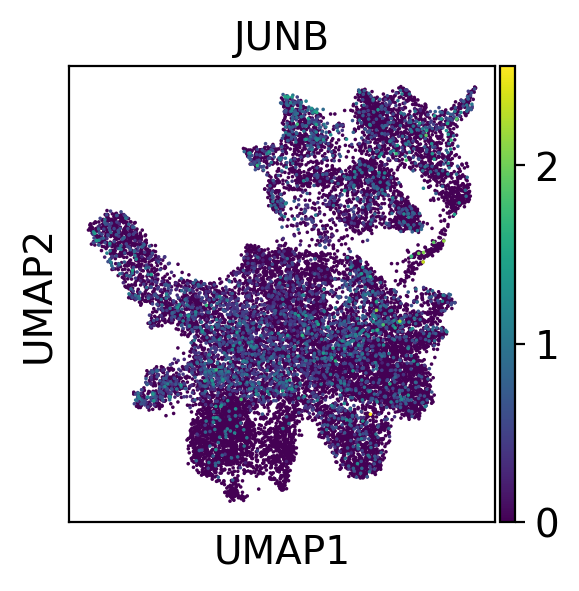

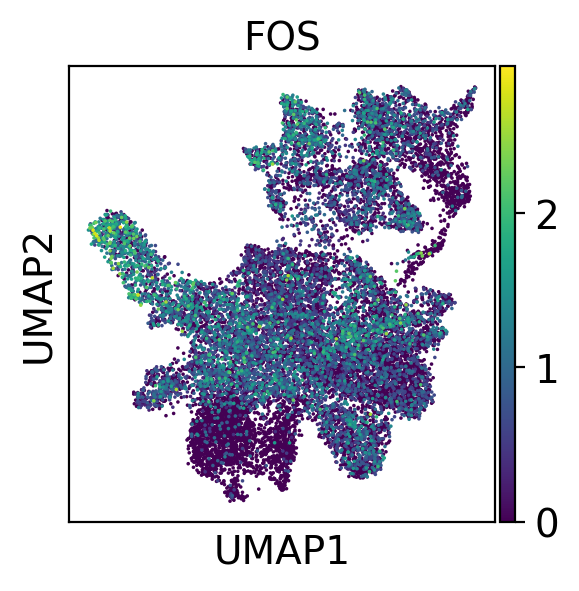

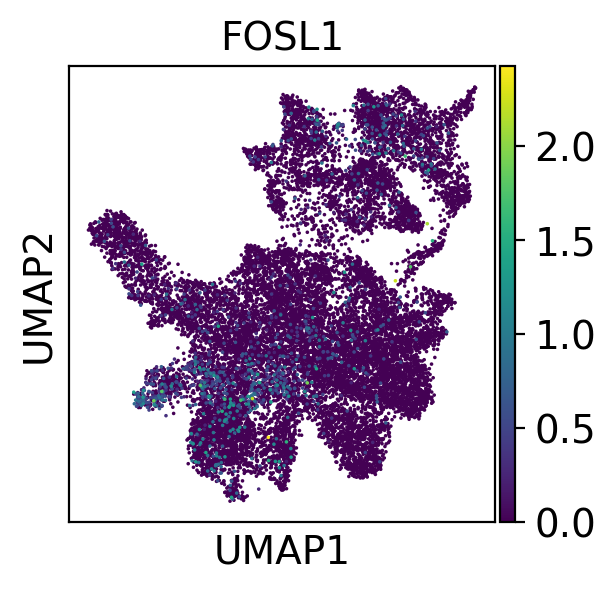

In [129]:
for TF in ['FOSL2', 
           'BATF3', 'SMARCC1', 'JUN', 'BACH2', 'BATF', 'JUND', 'ATF3', 'FOSB', 'INSM2', 'JUNB', 'FOS', 'FOSL1']:
    try:
        sc.pl.umap(adata,color=[TF])
    except:
        print(TF)

In [33]:
tf_me_summary = pd.read_csv("cistromes/tf_me_summary_DARs.tsv",sep="\t",index_col=0)

In [44]:
tf_me_summary['celltype'].value_counts()

0     2038
25    2038
8     2038
7     2038
6     2038
5     2038
4     2038
33    2038
32    2038
31    2038
30    2038
3     2038
29    2038
28    2038
27    2038
26    2038
24    2038
10    2038
23    2038
22    2038
21    2038
20    2038
2     2038
19    2038
18    2038
17    2038
16    2038
15    2038
14    2038
13    2038
12    2038
11    2038
9     2038
Name: celltype, dtype: int64

In [52]:
tst = tf_me_summary.pivot(values='mnes', index='celltype', columns='gene')

In [53]:
tst.index = [str(x) for x in tst.index]

In [54]:
umap_coords = pd.DataFrame(adata.obsm['X_umap'],index=adata.obs.index,columns=['umap_1','umap_2'])

In [63]:
sc_meta = pd.merge(sc_meta,umap_coords,left_index=True,right_index=True)

In [64]:
cond_clusters = [x for x in list(set(sc_meta['merged_clusters_from_4'])) if str(x) not in ['0','28']]
sc_meta_cond = sc_meta.loc[sc_meta['merged_clusters_from_4'].isin(cond_clusters)].copy()

In [65]:
sc_meta_cond.columns

Index(['sample', 'n_genes_by_counts', 'total_counts', 'total_counts_mt',
       'pct_counts_mt', 'n_genes', 'n_counts', 'doublet_score',
       'predicted_doublet', 'leiden_4', 'leiden_2', 'leiden_1', 'leiden_3',
       'leiden_0.5', 'leiden_0.25', 'leiden_0.75', 'leiden', 'CellID',
       'merged_clusters', 'final_clustering', 'final_clustering_reset',
       'merged_clusters_from_4', 'umap_1', 'umap_2'],
      dtype='object')

In [58]:
plot_order = df_plot_log_minmax.columns[df_plot_log_minmax.loc[gene]>0]
plot_order = list(df_plot_log_minmax.loc[gene,plot_order].sort_values().index)


NameError: name 'df_plot_log_minmax' is not defined

In [59]:
plotting_TFs = ['OTX2','HAND1','GRHL2','HNF1B','SOX6','RFX4','FOSL2']

In [ ]:
sns.clustermap(tst[plotting_TFs].T,cmap='Reds',figsize=(20,5))
plt.savefig("figures/ME_clusters_vs_control_selected_TFs_heatmap.png",dpi=350,bbox_inches='tight',pad_inches=0)
plt.show()
plt.close()

In [61]:
sc_meta_cond

,sample,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,n_genes,n_counts,doublet_score,predicted_doublet,leiden_4,...,M_SHH,M_CycA,M_NIM,M_N2B27_2Si,M_N2B27_SB_CHIR,umap_1_x,umap_2_x,umap_1_y,umap_2_y,color
AAACAGCCAAGTCGCT-1,iPSC_prepat_d5_1,3565,8014.0,450.0,5.615173,3565,8014.0,0.006024,False,12,...,0.073363,-0.098649,-0.206810,-0.192129,0.446027,10.781887,8.720945,10.781887,8.720945,0.0
AAACAGCCACATTGCA-1,iPSC_prepat_d5_1,4708,17233.0,995.0,5.773806,4708,17233.0,0.012519,False,2,...,-0.161293,-0.101230,0.392423,-0.219736,-0.193071,1.402084,5.212136,1.402084,5.212136,0.0
AAACAGCCAGCATGTC-1,iPSC_prepat_d5_1,4852,13375.0,911.0,6.811215,4852,13375.0,0.025396,False,31,...,-0.162947,0.158915,0.498303,0.055909,-0.619628,5.710542,1.974534,5.710542,1.974534,0.0
AAACAGCCATTCCTGT-1,iPSC_prepat_d5_1,8300,41629.0,2428.0,5.832472,8300,41629.0,0.051796,False,40,...,-0.228493,0.282541,0.211367,0.318256,-0.592136,5.911793,0.919488,5.911793,0.919488,0.0
AAACAGCCATTTAAGC-1,iPSC_prepat_d5_1,4603,11184.0,537.0,4.801502,4603,11184.0,0.063149,False,15,...,-0.161976,0.156799,0.513425,0.045357,-0.624737,3.012164,3.156642,3.012164,3.156642,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGGTGTGCAAC-1,iPSC_prepat_d5_2,2750,4830.0,20.0,0.414079,2750,4830.0,0.015504,False,17,...,0.186577,-0.103969,-0.225469,0.388949,-0.182776,8.820650,-2.619326,8.820650,-2.619326,0.0
TTTGTTGGTGTTGTAG-1,iPSC_prepat_d5_2,4694,13802.0,591.0,4.281988,4694,13802.0,0.013661,False,3,...,0.115133,-0.174695,-0.469118,-0.320677,0.883018,10.206653,10.225216,10.206653,10.225216,0.0
ACGCAAGCAGTAGGTG-1,iPSC_ctrl,570,780.0,3.0,0.384615,570,780.0,0.017521,False,44,...,-0.219616,0.273955,0.191945,0.321455,-0.573999,13.067187,6.308634,13.067187,6.308634,0.0
CATAATCCACTCAACA-1,iPSC_ctrl,563,704.0,4.0,0.568182,563,704.0,0.014257,False,44,...,-0.219616,0.273955,0.191945,0.321455,-0.573999,12.959983,6.344604,12.959983,6.344604,0.0


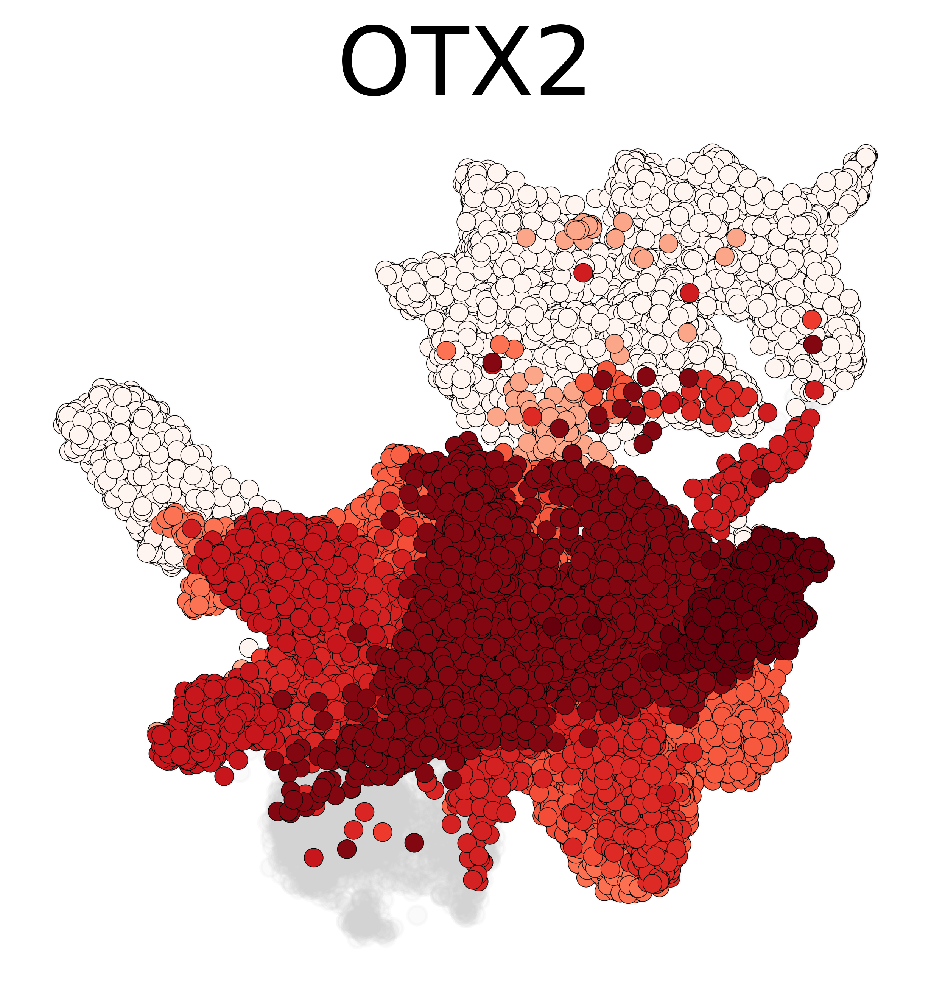

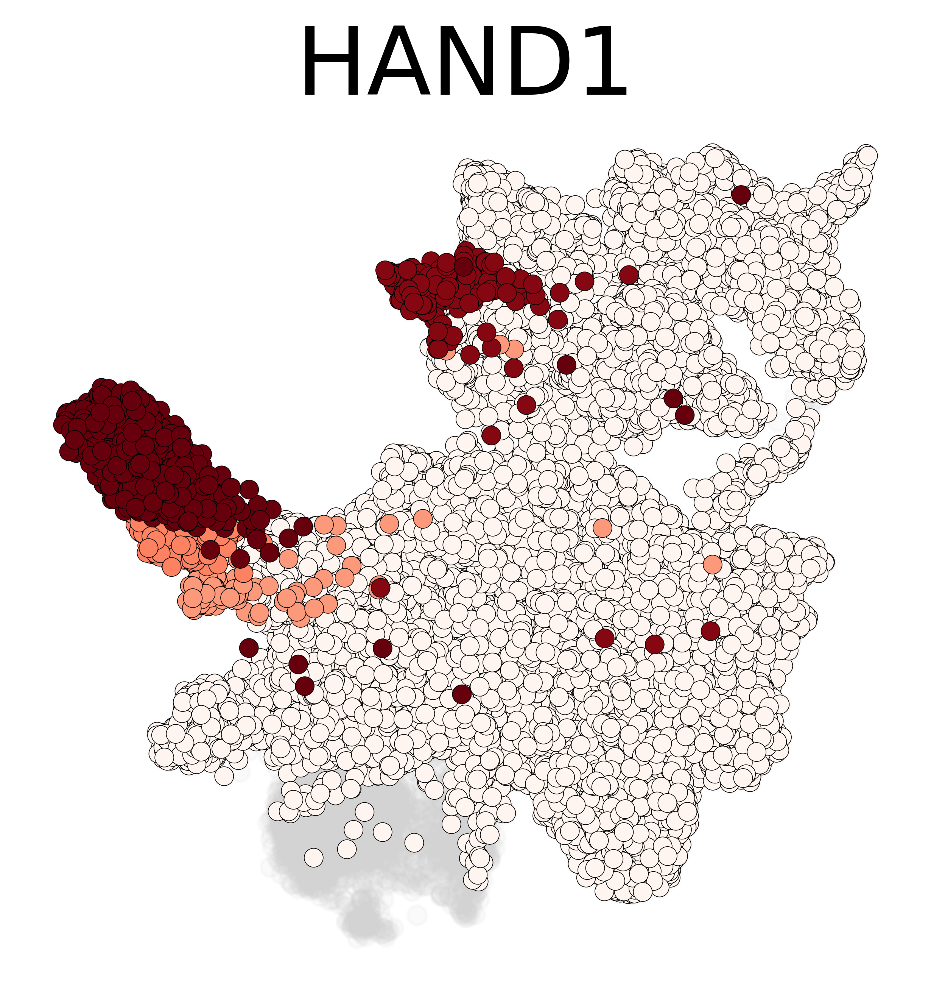

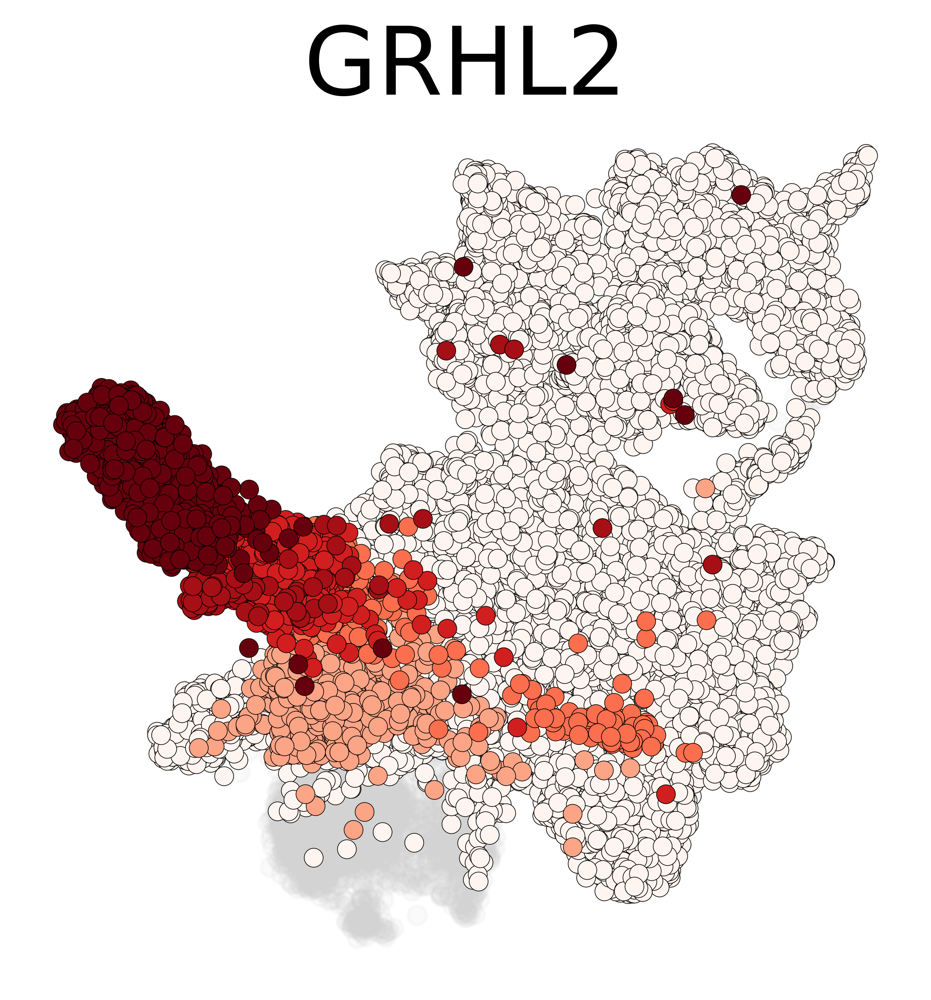

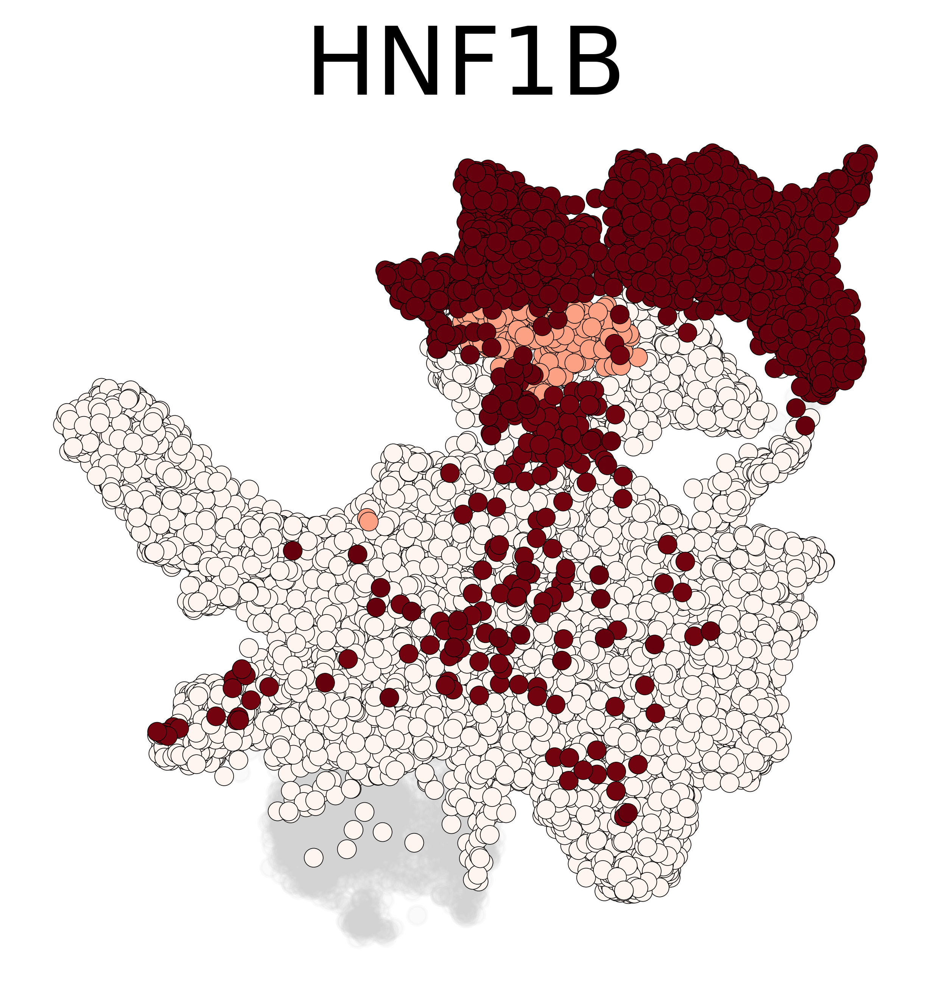

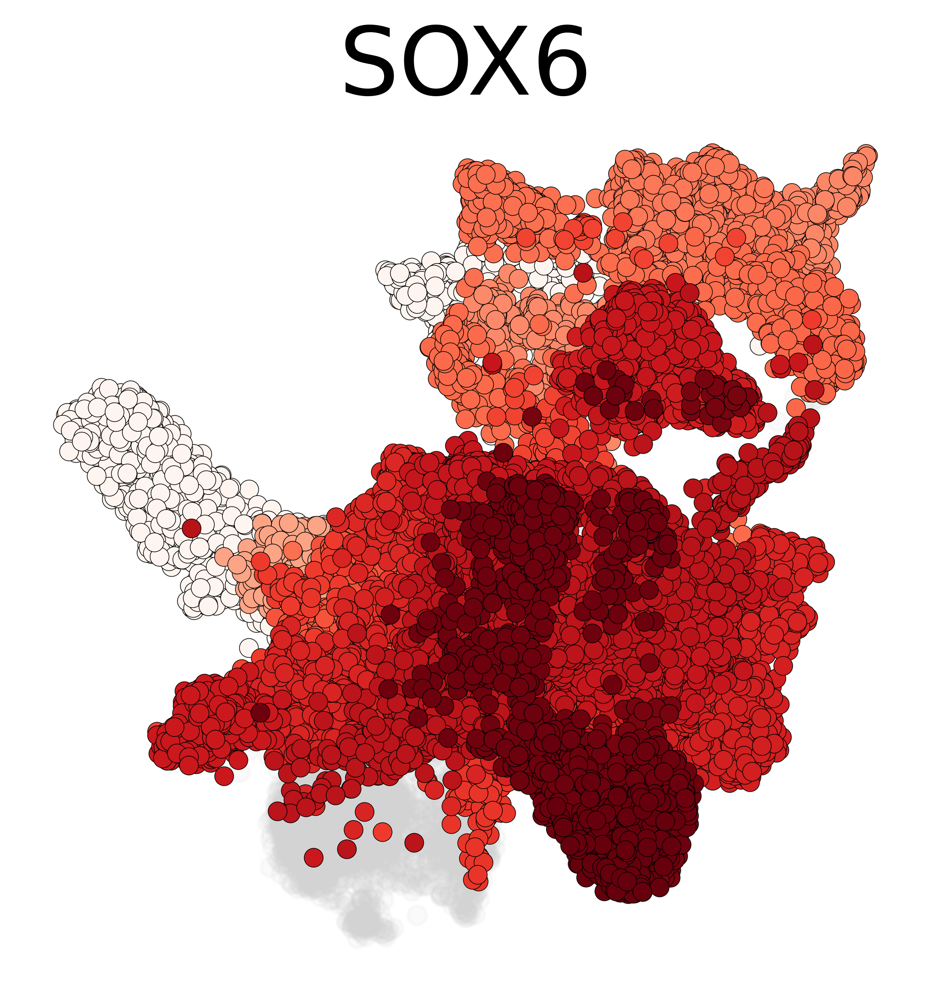

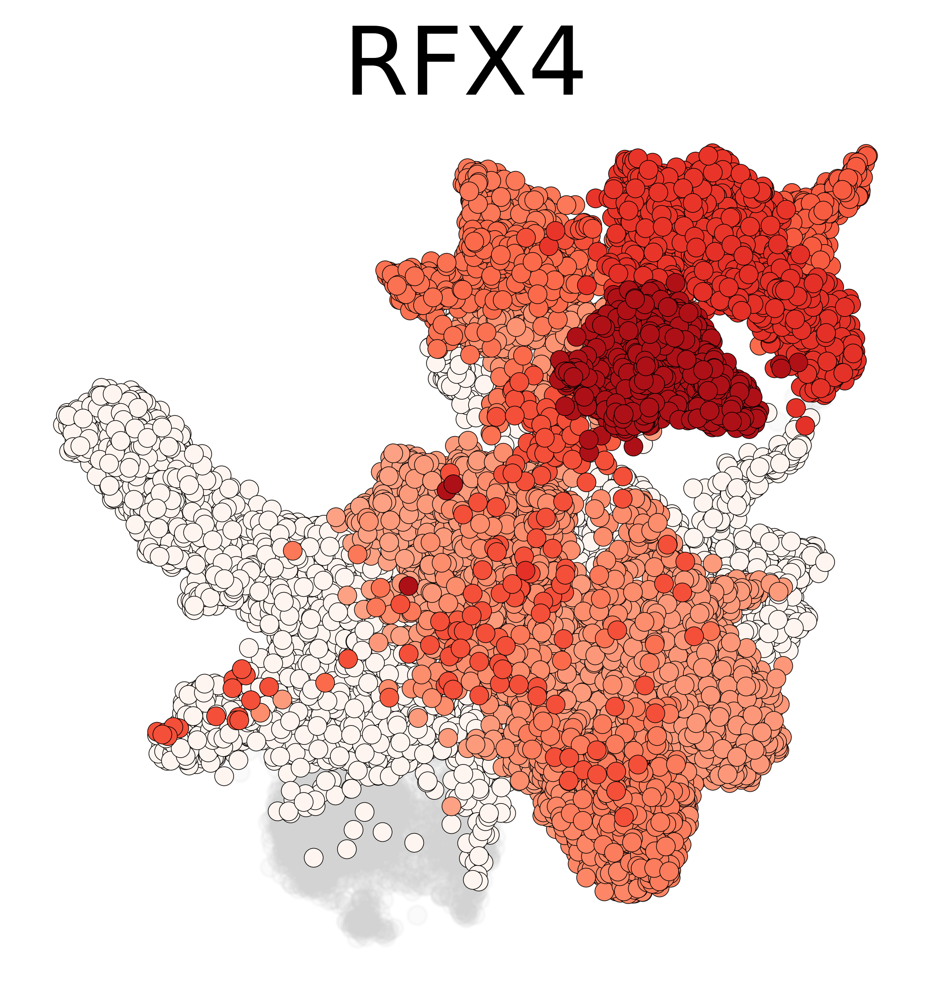

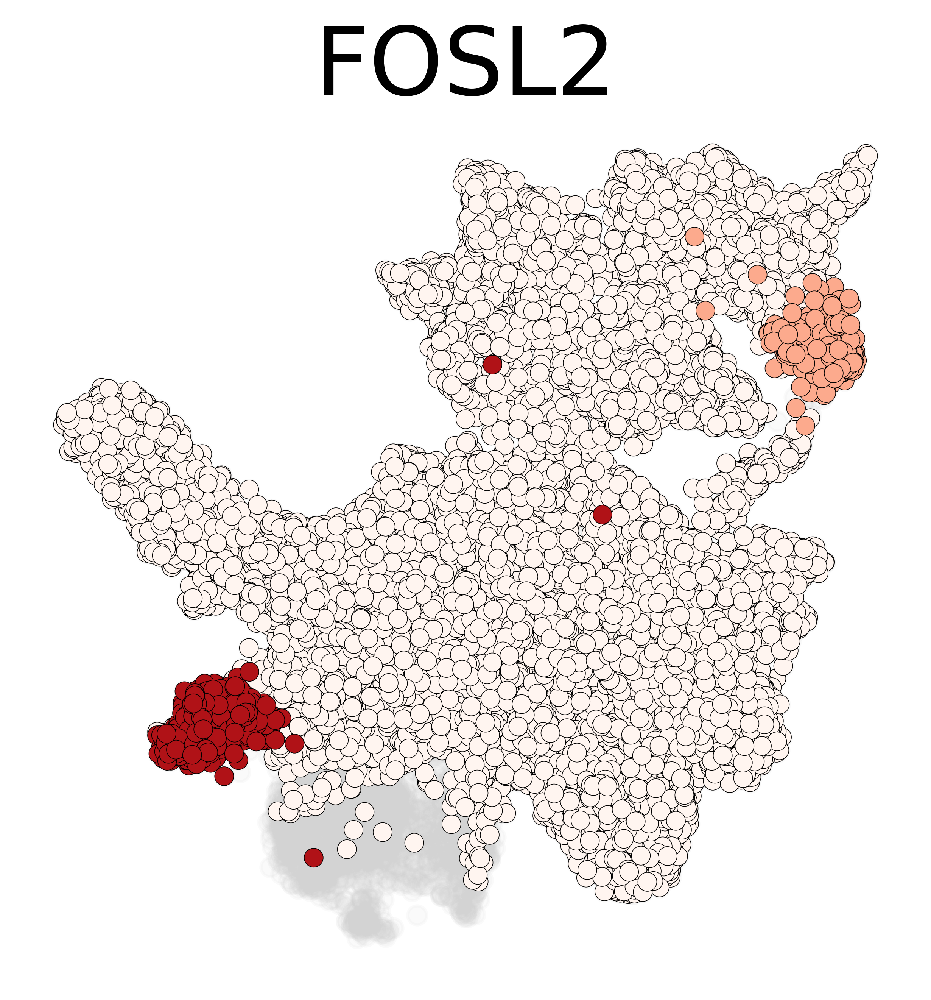

In [ ]:
#['OTX1','OTX2','PITX1','PITX2','PITX3','DPRX','GSC','GSC2','RAX','CRX','EVX1','EVX2','CDX1','TFAP2A','TFAP2C','ZNF611']:

for plotting_TF in ['OTX2','HAND1','GRHL2','HNF1B','SOX6','RFX4','FOSL2']:
    import matplotlib.gridspec as gridspec

    color_values = list(tst.loc[sc_meta_cond['merged_clusters_from_4'].astype('str'),plotting_TF])
    plot_order = pd.DataFrame(color_values,index=sc_meta_cond.index)
    plot_order = list(plot_order.sort_values(by=0).index)
    sc_meta_cond['color'] = color_values
    x="umap_1"
    y="umap_2"
    fig_size = (5,5)
    factor=225/255
    T=0.8
    markeredge_color = 'k'
    markeredge_width = 0.2

    fig, ax1 = plt.subplots(figsize=fig_size)

    cm = plt.cm.get_cmap('Reds')
    xy = range(20)
    z = xy
    #make background plot
    ax1.scatter(sc_meta[x], 
                     sc_meta[y],
                     c='lightgrey',
                     alpha=0.1)


    ax1.scatter(sc_meta_cond.loc[plot_order,x], sc_meta_cond.loc[plot_order,y], 
                     c=sc_meta_cond.loc[plot_order,'color'], cmap=cm,vmin=0,vmax=10,
                     edgecolors = markeredge_color,linewidths=markeredge_width)
    sns.despine(top=True,bottom=True,left=True,right=True,ax=ax1)
    ax1.set_title(plotting_TF,fontsize=30)
    ax1.set_yticks([])
    ax1.set_xticks([])

    fig.add_subplot(ax1)
    plt.savefig("figures/ME_clusters_vs_control_"+plotting_TF+".png",dpi=350,bbox_inches='tight',pad_inches=0)

    plt.show()
    plt.close()
    


In [ ]:
FOSL2, BATF3, SMARCC1, JUN, BACH2, BATF, JUND, ATF3, FOSB, INSM2, JUNB, FOS, FOSL1

In [32]:
selected_TFs = ['PAX6','OTX2','GRHL2']
selected_TFs = [x for x in selected_TFs if x in cluster_avg_subset.index]
    

In [45]:
cluster_avg_subset_minmax = (cluster_avg_subset.T-cluster_avg_subset.T.min())/(cluster_avg_subset.T.max()-cluster_avg_subset.T.min())
cluster_avg_subset_minmax = cluster_avg_subset_minmax.T
cluster_avg_subset_minmax = cluster_avg_subset_minmax.dropna()

selected_TFs = [x for x in HG_TFs if x in cluster_avg_subset_minmax.index]
print(len(selected_TFs))

2038


In [46]:
me_celltypes = list(menr['CTX_DARs_up_All'].keys())
rna_celltypes = list(cluster_avg_subset.columns)
common_celltypes = [x for x in me_celltypes if x in rna_celltypes]
print(len(common_celltypes))

32


In [47]:
for celltype in common_celltypes:
    print(celltype)
    me_obj = menr['CTX_DARs_up_All'][celltype]
    me_df = me_obj.motif_enrichment
    print(me_df.iloc[0]['Direct_annot'])

31
SREBF1, RFX3, RFX2, RFX5, MXI1, RFX4, RFX1, MAX, ZBTB7B
23
GSC, PITX2, CRX, DPRX, RHOXF2, PITX1, OTX2, OTX1, DMBX1, PITX3, GSC2, RAX, RHOXF1
25
GSC, PITX2, CRX, DPRX, RHOXF2, PITX1, OTX2, OTX1, DMBX1, PITX3, GSC2, RAX, RHOXF1
32
GSC, PITX2, CRX, DPRX, RHOXF2, PITX1, OTX2, OTX1, DMBX1, PITX3, GSC2, RAX, RHOXF1
6
SOX10, SOX3, SOX15, SOX2, SOX18, SMAD1, SOX6, SOX4, SOX9
2
SOX10, SOX3, SOX15, SOX2, SOX18, SMAD1, SOX6, SOX4, SOX9
12
HNF1A
5
GSC, PITX2, CRX, DPRX, RHOXF2, PITX1, OTX2, OTX1, DMBX1, PITX3, GSC2, RAX, RHOXF1
29
GSC, PITX2, CRX, DPRX, RHOXF2, PITX1, OTX2, OTX1, DMBX1, PITX3, GSC2, RAX, RHOXF1
24
HNF1A
27
HNF1A
19
HNF1A
33
HOXC12, CDX1
13
GSC, PITX2, CRX, DPRX, RHOXF2, PITX1, OTX2, OTX1, DMBX1, PITX3, GSC2, RAX, RHOXF1
22
SOX10, SOX3, SOX15, SOX2, SOX18, SMAD1, SOX6, SOX4, SOX9
3
HNF1A
26
SOX10, SOX3, SOX15, SOX2, SOX18, SMAD1, SOX6, SOX4, SOX9
4
GSC, PITX2, CRX, DPRX, RHOXF2, PITX1, OTX2, OTX1, DMBX1, PITX3, GSC2, RAX, RHOXF1
14
HNF1A
21
SOX18, SOX8, SOX10, SOX9
20
HNF1A
10
S

In [ ]:
from tqdm.notebook import tqdm
tf_me_summary = []
for gene in tqdm(selected_TFs):
    for celltype in common_celltypes:
        me_obj = menr['CTX_DARs_up_All'][celltype]
        me_df = me_obj.motif_enrichment
        mnes,TF_motif = find_TF_NES(me_df,gene)
        
        rna_expr = cluster_avg_subset_minmax.loc[gene,celltype]
        
        tf_me_summary.append(dict(celltype=celltype,gene=gene,
                                  mnes=mnes,TF_motif=TF_motif,
                                  rna_expr=rna_expr))
tf_me_summary = pd.DataFrame(tf_me_summary)

  0%|          | 0/2038 [00:00<?, ?it/s]

In [50]:
tf_me_summary = tf_me_summary.fillna(0)

In [51]:
tf_me_summary_max = tf_me_summary.groupby('gene').max()
TFs_use = list(tf_me_summary_max.loc[tf_me_summary_max['mnes']>0].index)

/tmp/ipykernel_344432/537139083.py:1: FutureWarning: Dropping invalid columns in DataFrameGroupBy.max is deprecated. In a future version, a TypeError will be raised. Before calling .max, select only columns which should be valid for the function.
  tf_me_summary_max = tf_me_summary.groupby('gene').max()


In [53]:
tf_me_summary_max = tf_me_summary.sort_values(by='mnes',ascending=False).groupby('gene').head(n=1)
TFs_use2 = list(tf_me_summary_max.loc[tf_me_summary_max['mnes']>0]['gene'])

In [54]:
tf_corr_summary = []
for gene in TFs_use:
    tf_me_summary_gene = tf_me_summary.loc[tf_me_summary['gene']==gene]
    import scipy
    tf_top_motif = list(tf_me_summary_gene.sort_values(by='mnes',ascending=False)['TF_motif'])[0]
    a = tf_me_summary_gene['mnes']
    b = tf_me_summary_gene['rna_expr']
    r_spearman,p_spearman = scipy.stats.spearmanr(a,b)
    r_pearson,p_pearson = scipy.stats.pearsonr(a,b)
    
    tf_corr_summary.append(dict(gene=gene,
                                r_spearman=r_spearman,p_spearman=p_spearman,
                                r_pearson=r_pearson,p_pearson=p_pearson,
                               tf_top_motif = tf_top_motif))
tf_corr_summary = pd.DataFrame(tf_corr_summary)

/links/groups/treutlein/USERS/jjans/anaconda3/envs/scenicplus/lib/python3.8/site-packages/scipy/stats/stats.py:4196: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/links/groups/treutlein/USERS/jjans/anaconda3/envs/scenicplus/lib/python3.8/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


In [58]:
tf_corr_summary.sort_values(by='r_pearson',ascending=False).head(n=20)

,gene,r_spearman,p_spearman,r_pearson,p_pearson,tf_top_motif
255,NR0B1,0.355893,4.559412e-02,0.994658,3.766821e-31,metacluster_11.2
236,NEUROG1,0.326950,6.777630e-02,0.992488,6.164956e-29,metacluster_193.2
78,FOXA2,0.630948,1.081569e-04,0.970791,3.750565e-20,metacluster_127.1
370,TFAP2A,0.758628,4.876595e-07,0.960544,3.187859e-18,metacluster_125.2
210,MAFF,0.301511,9.353647e-02,0.956302,1.433600e-17,metacluster_157.2
10,ASCL1,0.309739,8.450029e-02,0.936440,3.461026e-15,transfac_pro__M09767
276,OTX2,0.871205,8.825080e-11,0.923558,5.053191e-14,metacluster_0.2
120,GRHL2,0.681097,1.781501e-05,0.919650,1.039556e-13,metacluster_123.2
126,HAND1,0.574751,5.805270e-04,0.914715,2.457561e-13,metacluster_68.8
141,HNF1B,0.720816,3.269714e-06,0.899006,2.787264e-12,metacluster_74.13


In [24]:
tf_corr_summary_sig = tf_corr_summary.loc[tf_corr_summary['p_spearman']<0.05]

In [25]:
neg_corr = list(tf_corr_summary_sig.sort_values(by='r_spearman')['gene'][0:10])
pos_corr = list(tf_corr_summary_sig.sort_values(by='r_spearman',ascending=False)['gene'][0:10])

In [26]:
tf_corr_summary.loc[tf_corr_summary['gene']=='TEAD2']

,gene,r_spearman,p_spearman,r_pearson,p_pearson,tf_top_motif
419,TEAD2,-0.018222,0.919828,-0.022964,0.899059,metacluster_171.3


In [220]:
tf_corr_summary.loc[tf_corr_summary['gene']=='TEAD2']

,gene,r_spearman,p_spearman,r_pearson,p_pearson,tf_top_motif
444,TEAD2,-0.196371,0.185861,-0.13884,0.351996,metacluster_171.3


In [27]:
tf_corr_summary.loc[tf_corr_summary['gene']=='NEUROG2']

,gene,r_spearman,p_spearman,r_pearson,p_pearson,tf_top_motif
261,NEUROG2,0.297069,0.093177,0.704857,0.000005,metacluster_43.1


In [22]:
tf_corr_summary.loc[tf_corr_summary['gene']=='NEUROG2']

,gene,r_spearman,p_spearman,r_pearson,p_pearson,tf_top_motif
278,NEUROG2,0.250007,0.090105,0.703901,3.398400e-08,metacluster_43.1


In [55]:
menr['CTX_DARs_All'].keys()

dict_keys(['0', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '2', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '3', '30', '31', '32', '33', '4', '5', '6', '7', '8', '9', 'unknown'])

In [28]:
TF = 'FOXG1'
TF_motif_name = list(tf_corr_summary.loc[tf_corr_summary['gene']==TF,'tf_top_motif'])[0]
url = 'https://motifcollections.aertslab.org/v10nr_clust/logos/'+TF_motif_name+'.png'
print(url)

https://motifcollections.aertslab.org/v10nr_clust/logos/metacluster_134.3.png


In [258]:
tf_corr_summary

,gene,r_spearman,p_spearman,r_pearson,p_pearson,tf_top_motif
0,ABL1,-0.010870,0.942193,-0.009196,0.951080,transfac_pro__M08187
1,AFF4,-0.283801,0.053211,-0.285788,0.051495,hdpi__AFF4
2,AHDC1,-0.367952,0.010941,-0.265112,0.071710,metacluster_134.4
3,ALX1,-0.145481,0.329207,-0.213078,0.150425,metacluster_9.24
4,ALX3,0.109149,0.465190,0.027318,0.855367,metacluster_150.6
...,...,...,...,...,...,...
556,ZNF843,0.110873,0.458128,0.121685,0.415186,metacluster_1.9
557,ZNF875,-0.314069,0.031563,-0.395457,0.005937,metacluster_24.4
558,ZNF880,-0.290258,0.047798,-0.285901,0.051398,metacluster_133.2
559,ZNF90,0.108696,0.467059,0.100039,0.503467,kznf__ZNF90_Imbeault2017_OM_RCADE


In [49]:
for region_set in ['CTX_DARs_All', 'CTX_DARs_No_promoters']:
    region_set_ME = menr[region_set]
    for cluster in region_set_ME.keys():
        region_set_ME_cluster = region_set_ME[cluster]
        NEUROG2_cistromes = [x for x in region_set_ME_cluster.cistromes['Region_set'].keys() if 'NEUROG2' in x]
        if len(NEUROG2_cistromes)>0:
            print(cluster)

14
14


In [ ]:
for gene in list(tf_corr_summary['gene']):
    

In [120]:
tf_me_summary.sort_values(by='C_SHH')

,celltype,gene,mnes,TF_motif,rna_expr,C_RA,C_BMP4,C_SHH
0,0,A1CF,0.0,0,0.011855,0.000000,0.000000,0.000000
25974,12,NCOA1,0.0,0,0.394091,0.900950,0.900950,0.000000
25971,0,NCOA1,0.0,0,0.232270,0.000000,0.000000,0.000000
25967,6,NCBP2,0.0,0,0.728688,0.000000,0.063603,0.000000
25961,30,NCBP2,0.0,0,0.851280,0.900950,0.900950,0.000000
...,...,...,...,...,...,...,...,...
22330,3,LUZP1,0.0,0,0.417865,0.810824,0.176100,0.628372
22327,27,LUZP1,0.0,0,0.514800,0.810824,0.176100,0.628372
22324,24,LUZP1,0.0,0,0.081817,0.810824,0.176100,0.628372
42476,14,TFAP2C,0.0,0,0.017196,0.810824,0.176100,0.628372


In [58]:
tf_corr_summary.loc[tf_corr_summary['gene']=='NEUROG2']

,gene,r_spearman,p_spearman,r_pearson,p_pearson,tf_top_motif
261,NEUROG2,0.297069,0.093177,0.704857,0.000005,metacluster_43.1


In [266]:
cluster_morph_correlation.index = [str(x) for x in cluster_morph_correlation.index]

In [267]:
tf_me_summary['C_RA'] = list(cluster_morph_correlation.loc[tf_me_summary['celltype'],'M_RA'])
tf_me_summary['C_BMP4'] = list(cluster_morph_correlation.loc[tf_me_summary['celltype'],'M_BMP4'])
tf_me_summary['C_SHH'] = list(cluster_morph_correlation.loc[tf_me_summary['celltype'],'M_SHH'])
tf_me_summary['C_XAV'] = list(cluster_morph_correlation.loc[tf_me_summary['celltype'],'M_XAV'])
tf_me_summary['C_CHIR'] = list(cluster_morph_correlation.loc[tf_me_summary['celltype'],'M_CHIR'])
tf_me_summary['C_FGF8'] = list(cluster_morph_correlation.loc[tf_me_summary['celltype'],'M_FGF8'])

tf_me_summary['M_N2B27_SB_CHIR'] = list(cluster_morph_correlation.loc[tf_me_summary['celltype'],'M_N2B27_SB_CHIR'])
tf_me_summary['M_NIM'] = list(cluster_morph_correlation.loc[tf_me_summary['celltype'],'M_NIM'])
tf_me_summary['M_N2B27_2Si'] = list(cluster_morph_correlation.loc[tf_me_summary['celltype'],'M_N2B27_2Si'])

tf_me_summary = tf_me_summary.fillna(0)

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

pos_cor_TFs = list(tf_corr_summary.sort_values(by='r_pearson',ascending=False)['gene'][0:20])
neg_cor_TFs = list(tf_corr_summary.sort_values(by='r_pearson',ascending=True)['gene'][0:20])
SOX_TFs = [x for x in list(set(tf_me_summary['gene'])) if 'SOX' in x]
HOX_TFs = [x for x in list(set(tf_me_summary['gene'])) if 'HOX' in x]
PAX_TFs = [x for x in list(set(tf_me_summary['gene'])) if 'PAX' in x]
SMAD_TFs = [x for x in list(set(tf_me_summary['gene'])) if 'SMAD' in x]
RAR_TFs = [x for x in list(set(tf_me_summary['gene'])) if 'RAR' in x]


# Create some sample data
for TF_list in [pos_cor_TFs,neg_cor_TFs,SOX_TFs,HOX_TFs,PAX_TFs,SMAD_TFs,RAR_TFs]:
    for TF in TF_list:
        # Create a 1x3 grid of subplots using GridSpec for basal media
        fig = plt.figure(figsize=(12, 4))  # Adjust the figure size as needed
        gs = plt.GridSpec(1, 3, width_ratios=[1, 1, 1], height_ratios=[1])

        morph_cols_plot = ['M_N2B27_SB_CHIR','M_NIM','M_N2B27_2Si']
        l = 0
        # Create scatterplots in each subplot
        for i in range(1):
            for j in range(3):
                ax = plt.subplot(gs[i, j])
                morph_plot = morph_cols_plot[l]
                l+=1
                tf_me_summary_gene = tf_me_summary.loc[tf_me_summary['gene']==TF]
                x,y = tf_me_summary_gene['rna_expr'],tf_me_summary_gene['mnes']
                dot_size = tf_me_summary_gene[morph_plot]
                ax.scatter(x,y,c=dot_size,s=(5+dot_size*10)*10,linewidths=0.1,edgecolors='k',cmap='Reds')
                ax.set_xlabel('RNA expression (logCPM)')
                ax.set_ylabel('NES')
                ax.set_title(morph_plot)
        plt.suptitle(TF, fontsize=16)
        plt.tight_layout()  # Ensures proper spacing between subplots
        plt.savefig("figures/TF_ME_EXPR_"+TF+"_grid_BM.png",dpi=350,bbox_inches='tight',pad_inches=0)
        plt.show()
        plt.close()

        
        # Create a 2x3 grid of subplots using GridSpec for morphogens
        fig = plt.figure(figsize=(12, 8))  # Adjust the figure size as needed
        gs = plt.GridSpec(2, 3, width_ratios=[1, 1, 1], height_ratios=[1, 1])

        morph_cols_plot = ['C_RA','C_BMP4','C_SHH','C_XAV','C_CHIR','C_FGF8']
        l = 0
        # Create scatterplots in each subplot
        for i in range(2):
            for j in range(3):
                ax = plt.subplot(gs[i, j])
                morph_plot = morph_cols_plot[l]
                l+=1
                tf_me_summary_gene = tf_me_summary.loc[tf_me_summary['gene']==TF]
                x,y = tf_me_summary_gene['rna_expr'],tf_me_summary_gene['mnes']
                dot_size = tf_me_summary_gene[morph_plot]
                ax.scatter(x,y,c=dot_size,s=(5+dot_size*10)*10,linewidths=0.1,edgecolors='k',cmap='Reds')
                ax.set_xlabel('RNA expression (logCPM)')
                ax.set_ylabel('NES')
                ax.set_title(morph_plot)
        plt.suptitle(TF, fontsize=16)
        plt.tight_layout()  # Ensures proper spacing between subplots
        plt.savefig("figures/TF_ME_EXPR_"+TF+"_grid_morphogens.png",dpi=350,bbox_inches='tight',pad_inches=0)
        plt.show()
        plt.close()
